# Gestion des NaN

* Ouverture du fichier
* Identification des NaN
* Identification d'autres valeurs manquantes
* Stratégies
* Solutions
    1. les colonnes indiquant la direction du vent
    2. 





## Ouverture du fichier

In [25]:
import pandas as pd
import numpy as np

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

df = pd.read_csv('weatherAUS.csv', sep = ',', header = 0)
display(df.head())

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


## Identification des NaN

Les NaN sont très inégalement repartis. Les collones les plus affectés sont: `Evaporation`, `Sunshine`, `Cloud9am`, `Cloud3pm` avec d'environ 40%. Pour les autres on se trouve entre 0 et d'environ 10% de valeurs manquantes.



In [20]:
display(pd.DataFrame((df.isna().sum()/len(df))*100, columns=['% NaN']).round(decimals=2))

,% NaN
Date,0.00
Location,0.00
MinTemp,1.02
MaxTemp,0.87
Rainfall,2.24
Evaporation,43.17
Sunshine,48.01
WindGustDir,7.10
WindGustSpeed,7.06
WindDir9am,7.26


La repartition des NaN se visualisent plus facilement avec un Heatmap.

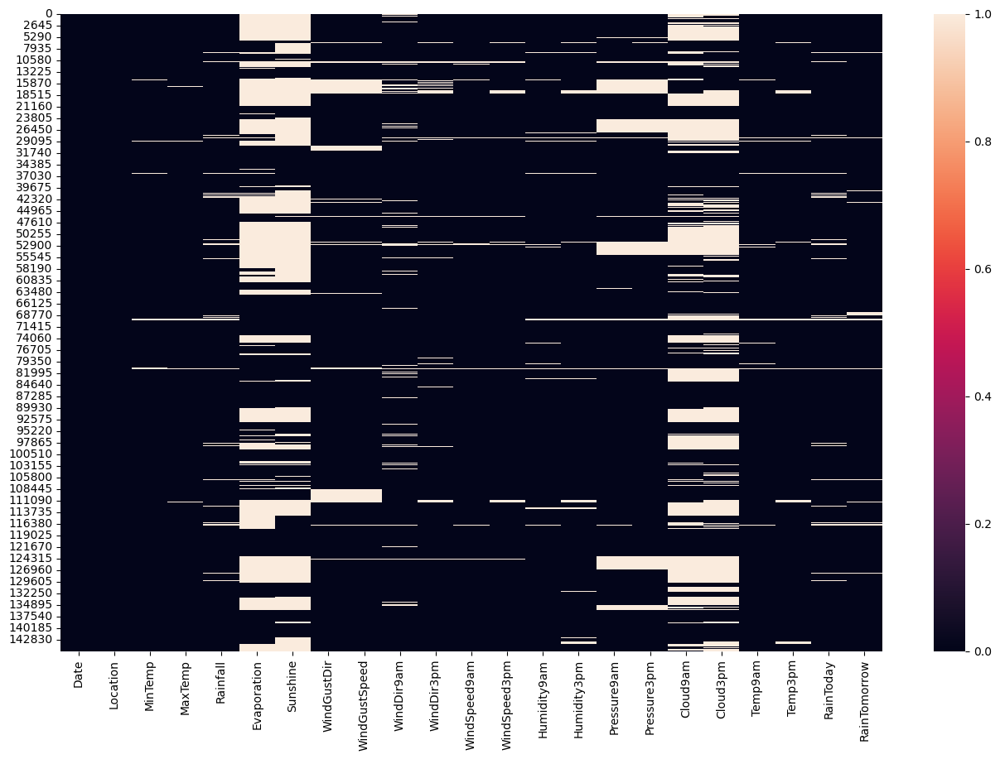

In [4]:
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize = (16, 10))
sns.heatmap(df.isna());

## Identification d'autres valeurs manquantes

L'identification eventuelle d'autres valeurs manquantes se fait par une examination des valeurs que peut prendre chaque variable.

In [5]:
L = ['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm', 'RainToday', 'RainTomorrow']
for x in L:
    display(x, df[x].unique())

'Location'

array(['Albury', 'BadgerysCreek', 'Cobar', 'CoffsHarbour', 'Moree',
       'Newcastle', 'NorahHead', 'NorfolkIsland', 'Penrith', 'Richmond',
       'Sydney', 'SydneyAirport', 'WaggaWagga', 'Williamtown',
       'Wollongong', 'Canberra', 'Tuggeranong', 'MountGinini', 'Ballarat',
       'Bendigo', 'Sale', 'MelbourneAirport', 'Melbourne', 'Mildura',
       'Nhil', 'Portland', 'Watsonia', 'Dartmoor', 'Brisbane', 'Cairns',
       'GoldCoast', 'Townsville', 'Adelaide', 'MountGambier', 'Nuriootpa',
       'Woomera', 'Albany', 'Witchcliffe', 'PearceRAAF', 'PerthAirport',
       'Perth', 'SalmonGums', 'Walpole', 'Hobart', 'Launceston',
       'AliceSprings', 'Darwin', 'Katherine', 'Uluru'], dtype=object)

'MinTemp'

array([13.4,  7.4, 12.9,  9.2, 17.5, 14.6, 14.3,  7.7,  9.7, 13.1, 15.9,
       12.6,  8.4,  9.8, 14.1, 13.5, 11.2, 11.5, 17.1, 20.5, 15.3, 16.2,
       16.9, 20.1, 19.7, 12.5, 12. , 11.3,  9.6, 10.5, 12.3, 13.7, 16.1,
       14. , 17. , 17.3, 17.2, 17.4, 19.8, 14.9, 13.9, 18.6, 19.3, 24.4,
       18.8, 20.8, 15.7, 18.5, 20.4, 21.8, 22.3, 22. , 28. , 21.5, 21.7,
       23.5, 28.3, 18.4, 12.4, 13.3, 18. , 18.7, 15.5,  8.9, 15. , 15.4,
       16. , 12.8, 13.2, 13.8,  7.6,  8.3, 11. , 20.9, 16.4, 10. ,  8.8,
        9.3, 14.4, 10.8, 10.1,  9.1, 10.4, 12.2, 10.7,  7.8,  8.1,  7.5,
        8.2, 11.6, 13. ,  9.9,  3.5,  6.6,  7. ,  5.7,  6.2,  6. , 10.6,
        8.6,  4.5,  5.4,  2.1,  1.8,  7.2,  4.6,  4.2,  5.2,  4.1,  3.2,
        4.3,  3.7,  3.6,  6.9, 10.3,  3. ,  2.6,  5.1,  4.4,  4.7,  6.7,
        8. ,  2.2,  1.7,  2.8,  9. ,  6.3, -2. , -1.3,  2. ,  0.5,  1.2,
        0.6,  0.9,  5. ,  3.9,  3.4,  0. , -1.5, -1.7, -0.4,  0.1,  4.8,
        5.9,  2.9, -0.6, -0.3, -1. ,  0.8, -0.1,  1

'MaxTemp'

array([22.9, 25.1, 25.7, 28. , 32.3, 29.7, 25. , 26.7, 31.9, 30.1, 30.4,
       21.7, 18.6, 21. , 24.6, 27.7, 20.9, 22.5, 25.6, 29.3, 33. , 31.8,
       30.9, 32.4, 33.9, 32.7, 27.2, 24.2, 24.4, 26.5, 23.9, 28.8, 34.6,
       35.8, 37.9, 38.9, 28.3, 28.4, 30.8, 32. , 34.7, 37.7, 43. , 32.2,
       36.6, 39.9, 38.1, 34. , 35.2, 30.6, 34.3, 38.4, 38.2, 40.7, 41.5,
       42.9, 42.7, 43.1, 38.3, 36.9, 41.2, 42.2, 44.8, 40.2, 31.2, 27.3,
       21.6, 29. , 29.2, 31.3, 31.1, 29.1, 31.7, 33.2, 29.6, 32.6, 34.5,
       30.3, 22.1, 22. , 24. , 27.9, 30.2, 30.5, 25.8, 27. , 19.7, 21.9,
       25.3, 33.5, 33.6, 30. , 31.6, 22.3, 29.8, 27.6, 28.9, 29.9, 32.1,
       28.1, 21.4, 24.9, 25.4, 20. , 23.4, 22.7, 16.2, 15.8, 12.9, 11.5,
       14.5, 12.2, 16.5, 17. , 19.2, 18.9, 19.1, 18.8, 19.3, 18.4, 19. ,
       20.5, 19.5, 17.7, 18.5, 15.1, 16.3, 16.6, 16.4, 15.6, 19.8, 21.1,
       20.3, 18.1, 15.7, 16.8, 17.1, 14.3, 13.4, 17.4, 16.1, 10.5, 11.6,
       12. ,  8.8,  9.6,  8.2, 12.4, 14.9, 15.9, 14

'Rainfall'

array([6.000e-01, 0.000e+00, 1.000e+00, 2.000e-01, 1.400e+00, 2.200e+00,
       1.560e+01, 3.600e+00,       nan, 1.680e+01, 1.060e+01, 1.200e+00,
       8.000e-01, 6.400e+00, 4.000e-01, 3.000e+00, 5.800e+00, 1.160e+01,
       1.800e+00, 8.600e+00, 1.260e+01, 8.400e+00, 6.200e+00, 2.000e+01,
       2.100e+01, 3.200e+00, 4.800e+00, 4.200e+00, 8.000e+00, 1.440e+01,
       4.600e+00, 2.000e+00, 5.600e+00, 1.600e+00, 6.000e+00, 4.400e+00,
       5.400e+00, 5.000e+00, 7.800e+00, 6.800e+00, 9.800e+00, 3.800e+00,
       2.400e+00, 5.200e+00, 6.600e+00, 1.340e+01, 1.020e+01, 2.880e+01,
       7.000e+00, 2.580e+01, 9.400e+00, 1.240e+01, 5.220e+01, 2.060e+01,
       6.600e+01, 1.100e+01, 1.700e+01, 1.040e+01, 2.800e+01, 2.140e+01,
       1.860e+01, 7.200e+00, 8.200e+00, 1.080e+01, 1.540e+01, 9.600e+00,
       4.000e+00, 2.180e+01, 2.080e+01, 2.480e+01, 1.000e+01, 1.140e+01,
       1.900e+01, 2.220e+01, 3.280e+01, 3.400e+00, 5.080e+01, 5.260e+01,
       1.920e+01, 1.880e+01, 1.480e+01, 1.200e+01, 

'Evaporation'

array([     nan, 1.20e+01, 1.48e+01, 1.26e+01, 1.08e+01, 1.14e+01,
       1.12e+01, 1.30e+01, 9.80e+00, 1.46e+01, 1.10e+01, 1.28e+01,
       1.38e+01, 1.64e+01, 1.74e+01, 1.60e+01, 1.36e+01, 8.00e+00,
       8.20e+00, 8.60e+00, 1.42e+01, 1.58e+01, 1.62e+01, 1.34e+01,
       1.44e+01, 1.18e+01, 1.56e+01, 1.52e+01, 1.16e+01, 9.60e+00,
       6.60e+00, 6.00e-01, 6.00e+00, 3.00e+00, 2.00e+00, 5.20e+00,
       9.00e+00, 1.02e+01, 1.00e+01, 7.40e+00, 8.40e+00, 9.20e+00,
       9.40e+00, 1.24e+01, 1.04e+01, 7.20e+00, 6.80e+00, 7.60e+00,
       4.40e+00, 6.40e+00, 7.80e+00, 7.00e+00, 8.80e+00, 6.20e+00,
       5.80e+00, 2.00e-01, 2.40e+00, 1.80e+00, 2.20e+00, 2.80e+00,
       5.00e+00, 5.60e+00, 4.80e+00, 4.20e+00, 4.00e+00, 3.20e+00,
       4.60e+00, 3.40e+00, 3.60e+00, 0.00e+00, 1.40e+00, 3.80e+00,
       8.00e-01, 2.60e+00, 1.60e+00, 1.20e+00, 1.00e+00, 5.40e+00,
       1.06e+01, 1.68e+01, 1.70e+01, 2.02e+01, 1.40e+01, 1.72e+01,
       1.22e+01, 1.50e+01, 1.82e+01, 1.32e+01, 4.10e+00, 1.70e

'Sunshine'

array([ nan, 12.3, 13. , 13.3, 10.6, 12.2,  8.4,  0. , 12.6, 13.2, 12.7,
       12.1, 10.3, 13.1, 12.9, 11.3,  6.9, 10.9,  3.7,  5.9, 10.5, 12.4,
       13.4, 13.6,  7.4, 10. ,  2.3,  6.6,  0.3, 10.7, 11.6, 10.2,  9. ,
       12. ,  3. ,  7.9, 11.5, 11.2,  4.8,  5.8,  6. , 11.1, 11.8, 11.4,
       10.8,  7.8, 11. ,  5.5,  4.7,  4.2,  4.4,  6.2,  9.8,  9.9,  4.3,
        8. ,  9.6, 10.4,  9.3,  8.7,  7.6,  7.5, 10.1,  6.3,  2.8,  0.7,
        9.4,  9.7,  0.6,  5.1,  8.3,  4.1,  3.9,  6.8,  8.6,  2.7,  8.2,
        3.1,  1.8,  0.1,  0.8,  3.4,  7.1,  5. ,  5.7,  6.1,  7. ,  2.9,
        2.5,  4.6,  8.9,  9.1,  1.7,  8.1,  9.5,  1.2,  1.4,  8.8,  2.2,
        3.5,  9.2,  1.9, 11.7, 11.9,  7.7,  0.9, 12.5,  2.1, 12.8, 13.7,
        8.5,  0.2,  4. ,  2.4,  5.2,  0.5,  6.4,  4.5,  1.1,  2. ,  0.4,
        1.5,  3.3,  6.5,  2.6,  3.8,  3.6,  3.2,  6.7,  5.4,  7.2,  4.9,
        1. ,  1.6,  5.3,  7.3,  5.6,  1.3, 13.8, 13.5, 14. , 13.9, 14.1,
       14.5, 14.3, 14.2])

'WindGustDir'

array(['W', 'WNW', 'WSW', 'NE', 'NNW', 'N', 'NNE', 'SW', nan, 'ENE',
       'SSE', 'S', 'NW', 'SE', 'ESE', 'E', 'SSW'], dtype=object)

'WindGustSpeed'

array([ 44.,  46.,  24.,  41.,  56.,  50.,  35.,  80.,  28.,  30.,  31.,
        61.,  nan,  22.,  63.,  43.,  26.,  33.,  57.,  48.,  39.,  37.,
        52.,  98.,  54.,  83.,  59.,  70.,  69.,  17.,  20.,  19.,  15.,
        13.,  11.,  72.,  85.,  65.,  78., 107.,  74.,  67.,  94.,  76.,
        81.,  87.,   9.,   7.,  89.,  91.,  93., 102., 100., 113., 117.,
        96., 111., 106., 135., 104., 120., 115., 126., 109., 122., 124.,
       130.,   6.])

'WindDir9am'

array(['W', 'NNW', 'SE', 'ENE', 'SW', 'SSE', 'S', 'NE', nan, 'SSW', 'N',
       'WSW', 'ESE', 'E', 'NW', 'WNW', 'NNE'], dtype=object)

'WindDir3pm'

array(['WNW', 'WSW', 'E', 'NW', 'W', 'SSE', 'ESE', 'ENE', 'NNW', 'SSW',
       'SW', 'SE', 'N', 'S', 'NNE', nan, 'NE'], dtype=object)

'WindSpeed9am'

array([ 20.,   4.,  19.,  11.,   7.,   6.,  15.,  17.,  28.,  24.,  nan,
         9.,   0.,  13.,   2.,  26.,  30.,  22.,  35.,  37.,  31.,  33.,
        48.,  39.,  44.,  43.,  41.,  46.,  56.,  83.,  74.,  52.,  65.,
        50., 130.,  54.,  61.,  57.,  59.,  87.,  67.,  63.,  69.,  72.])

'WindSpeed3pm'

array([24., 22., 26.,  9., 20., 17., 28., 11.,  6., 13., 30., 19., 31.,
        7., 15., 48.,  4., 33.,  0.,  2., nan, 37., 46., 39., 50., 35.,
       44., 41., 43., 56., 61., 54., 52., 83., 65., 78., 57., 63., 59.,
       74., 72., 69., 76., 87., 67.])

'Humidity9am'

array([ 71.,  44.,  38.,  45.,  82.,  55.,  49.,  48.,  42.,  58.,  89.,
        76.,  65.,  57.,  50.,  69.,  80.,  47.,  56.,  54.,  41.,  78.,
        46.,  43.,  33.,  34.,  36.,  52.,  51.,  40.,  35.,  39.,  60.,
        37.,  27.,  32.,  53.,  20.,  66.,  63.,  62.,  87.,  61.,  59.,
        92.,  72.,  67.,  75.,  88.,  68.,  73.,  74.,  83.,  77.,  70.,
        81.,  86.,  97.,  99.,  91.,  85.,  93.,  84.,  94.,  79.,  98.,
        96.,  95.,  90.,  64.,  29.,  21., 100.,  nan,  24.,  25.,  31.,
        18.,  23.,  26.,  28.,  30.,  19.,  22.,  17.,  15.,   9.,  12.,
        13.,  16.,   6.,  10.,  14.,  11.,   7.,   8.,   5.,   3.,   2.,
         4.,   0.,   1.])

'Humidity3pm'

array([ 22.,  25.,  30.,  16.,  33.,  23.,  19.,   9.,  27.,  91.,  93.,
        43.,  32.,  28.,  82.,  65.,  26.,  24.,  17.,  15.,  70.,  12.,
         8.,  31.,  20.,  10.,  21.,  39.,  13.,  11.,  69.,  18.,  14.,
        35.,  90.,  68.,  74.,  41.,  34.,  78.,  49.,  37.,  42.,  47.,
        52.,  29.,  86.,  89.,  62.,  79.,  48.,  46.,  38.,  44.,  51.,
        36.,  45.,  40.,  53.,  61.,  59.,  63.,  54.,  57.,  50.,  58.,
        75.,  97.,  80.,  95.,  56.,  72.,  60.,  71.,  73.,  81.,  76.,
        64.,  87.,  85.,  67.,  55.,  77.,  84.,   7.,  99.,  92.,  66.,
        83.,  94.,  96.,  88.,  nan, 100.,  98.,   5.,   6.,   1.,   4.,
         2.,   3.,   0.])

'Pressure9am'

array([1007.7, 1010.6, 1007.6, 1017.6, 1010.8, 1009.2, 1009.6, 1013.4,
       1008.9, 1007. , 1011.8, 1010.5,  994.3, 1001.2, 1009.7, 1012.2,
       1005.8, 1009.4, 1019.2, 1019.3, 1013.6, 1007.8, 1011. , 1012.9,
       1010.9, 1006.8, 1005.2, 1004.8, 1005.6, 1006.1, 1004.5, 1014.4,
       1018.7, 1015.1, 1012.6, 1011.9, 1017.8, 1009.9, 1014.1, 1015.7,
       1011.6, 1008.4, 1019.7, 1015.8, 1010.1, 1005.3, 1007.9, 1005.4,
       1016.5, 1017.7, 1014.9, 1014.6, 1014.2, 1012.5, 1011.7, 1008.8,
       1005.9, 1008. , 1008.2, 1009.3, 1012.8, 1017. , 1023.3, 1022.5,
       1016.2, 1017.2, 1012.4, 1015.6, 1013. , 1014. , 1016.6, 1007.5,
       1014.7, 1014.5, 1013.7, 1015.2, 1019.5, 1021.3, 1017.4, 1012.7,
       1013.3, 1016.3, 1014.8, 1019.1, 1023. , 1023.8, 1022.4, 1023.2,
       1022.6, 1018.8, 1019.8, 1020.4, 1021.8, 1026.7, 1027.1, 1024.2,
       1021.5, 1024.4, 1024.1, 1018.5, 1022.8, 1022.7, 1023.6, 1025.2,
       1026. , 1004. , 1013.8, 1018. , 1023.1, 1023.4, 1026.9, 1028.7,
      

'Pressure3pm'

array([1007.1  , 1007.8  , 1008.7  , 1012.8  , 1006.   , 1005.4  ,
       1008.2  , 1010.1  , 1003.6  , 1005.7  , 1004.2  ,  993.   ,
       1001.8  , 1010.3  , 1010.4  , 1002.2  , 1009.7  , 1017.1  ,
       1014.8  , 1008.1  , 1007.6  , 1001.7  , 1003.4  , 1005.1  ,
       1003.2  , 1013.1  , 1009.2  , 1006.7  , 1002.7  , 1010.9  ,
       1013.7  , 1006.8  , 1012.1  , 1006.9  , 1012.7  , 1017.4  ,
       1016.2  , 1010.6  , 1004.8  , 1005.9  ,  997.8  , 1003.9  ,
       1014.6  , 1014.1  , 1011.6  , 1011.8  , 1010.2  , 1010.5  ,
       1007.4  , 1004.7  , 1002.6  , 1005.   , 1003.8  , 1006.5  ,
       1008.5  , 1011.1  , 1017.3  , 1019.7  , 1016.4  , 1013.8  ,
       1013.5  , 1007.5  , 1004.5  , 1010.8  , 1012.4  , 1013.4  ,
       1015.   , 1012.6  , 1004.6  , 1009.   , 1012.   , 1014.7  ,
       1015.9  , 1018.   , 1018.9  , 1008.   , 1013.2  , 1013.9  ,
       1013.6  , 1014.4  , 1019.2  , 1017.2  , 1020.7  , 1020.6  ,
       1019.1  , 1019.5  , 1019.4  , 1018.4  , 1012.9  , 1019.

'Cloud9am'

array([ 8., nan,  7.,  1.,  0.,  5.,  4.,  2.,  6.,  3.,  9.])

'Cloud3pm'

array([nan,  2.,  8.,  7.,  1.,  5.,  4.,  6.,  3.,  0.,  9.])

'Temp9am'

array([16.9, 17.2, 21. , 18.1, 17.8, 20.6, 16.3, 18.3, 20.1, 20.4, 15.9,
       17.4, 15.8, 17.3, 18. , 15.5, 19.1, 24.5, 23.8, 20.9, 21.5, 23.2,
       26.6, 24.6, 21.6, 12.5, 19.7, 14.9, 17.1, 20.7, 22.4, 23.1, 25.2,
       17.9, 20.2, 22.8, 24.2, 24.3, 25.6, 27.6, 16. , 22. , 26.8, 27.3,
       26.1, 23.3, 21.2, 23.4, 25.8, 28.2, 29. , 29.2, 29.9, 32.4, 28.8,
       27.2, 25.5, 26.5, 28.7, 29.6, 34.5, 18.7, 16.7, 17. , 19.2, 21.4,
       22.1, 19.3, 15. , 20. , 22.2, 23. , 15.6, 13.9, 12.6, 13.3, 17.6,
       18.6, 19. , 19.9, 12.7, 12.2, 12.1, 14.7, 18.8, 15.4, 16.2, 16.5,
       14. , 16.6, 18.4, 12.9, 13.8, 15.1, 16.4, 16.1, 20.5,  9.6, 12.4,
       14.1, 11.2,  9.5,  7.6, 10.1,  8.2,  7.9,  7.2, 10.6, 10.3, 10. ,
        8.3, 11. ,  9.4, 11.7,  8.5,  9.1,  7.5, 13. ,  7. ,  8.8,  7.4,
       11.9, 11.6, 13.6,  7.1, 10.2,  8. ,  9.2, 11.3,  4.7,  6.8,  4.9,
        2.2,  1.9,  5.9,  6.5,  5.4,  6.6,  5.6,  6.9,  8.4,  9.8, 13.5,
        7.8,  2.3,  2.4,  3.3,  3.8,  4.8,  8.1,  9

'Temp3pm'

array([21.8, 24.3, 23.2, 26.5, 29.7, 28.9, 24.6, 25.5, 30.2, 28.2, 28.8,
       17. , 15.8, 19.8, 23.5, 26.2, 18.1, 21.5, 21. , 27.3, 31.6, 30.8,
       29. , 31.2, 33. , 32.1, 26.1, 18.2, 22.7, 25.7, 22.1, 33.9, 34.4,
       36.8, 38.4, 27.6, 26.6, 29.3, 30. , 33.2, 35.7, 41.5, 27.1, 25.8,
       30.5, 37.7, 36.1, 33.1, 36.5, 36.2, 39.2, 40.1, 41.2, 42. , 41.9,
       37.1, 35.2, 39.7, 41.6, 43.4, 38.5, 29.4, 24.9, 17.3, 28.5, 29.2,
       29.5, 27. , 30.7, 32.7, 26.8, 29.8, 31.3, 33.4, 28.6, 33.6, 28.1,
       21.9, 21.4, 22. , 29.6, 18.8, 23.8, 19.7, 18.3, 20.5, 23.9, 27.2,
       32.6, 33.5, 31.4, 19.6, 27.7, 29.9, 30.9, 27.4, 20.3, 21.2, 20.9,
       21.6, 25. , 24.4, 23.1, 18.9, 19.4, 22.9, 23.6, 21.3, 22.3, 22.6,
       15.1, 14.5, 11.6,  9.4, 14. , 12.1, 16.1, 16.3, 19.1, 18.5, 18.4,
       19.2, 20.2, 17.7, 18. , 14.6, 15.3, 15.9, 14.7, 18.7, 21.7, 20.8,
       19.5, 17.4, 15.6, 16.7, 16.8, 13.4, 13. , 16.5, 10.2, 11.5, 11.4,
        7.9,  9.7,  8.8, 15.5, 13.9, 15.4, 14.9, 16

'RainToday'

array(['No', 'Yes', nan], dtype=object)

'RainTomorrow'

array(['No', 'Yes', nan], dtype=object)

On contate que à part des NaN, il n'y a pas d'autres valeurs manquantes.

## Stratégies

* Réduire le besoin de remplacer les NaN ce qui risque toujours de fausser le résultat.
    1. Voir la repartition dans le temps pour eventuellement identifier des plages moins touchés.
    2. Voir la répartition par ville pour eventuellement identifier des villes moins touchés.


### Répartition dans le temps

Nous regardons la répartition par l'année. Les données pour 2007 existent uniquement pour Canberra. 



In [8]:
df['Date'] = pd.to_datetime(df['Date'], format = '%Y-%m-%d') 
df['Year'] = df['Date'].dt.year

df_nan_date = df.groupby('Year').count().rsub(df.groupby('Year').size(), axis=0)
display(df_nan_date)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Year,,,,,,,,,,,,,,,,,,,,,,,
2007,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2008,0,0,11,8,25,339,323,453,452,92,23,30,19,25,23,95,94,379,389,19,16,25,24
2009,0,0,207,158,195,5714,6146,1718,1716,1383,568,410,434,278,303,1745,1746,5567,5802,233,265,195,194
2010,0,0,201,144,360,5925,6220,1546,1543,1511,543,419,373,295,246,1624,1618,5532,5683,267,232,360,363
2011,0,0,70,46,282,5797,6053,1028,1026,1036,271,92,116,201,157,1559,1542,5840,6078,176,136,282,281
2012,0,0,59,47,366,6056,6539,877,872,1138,248,87,120,466,420,1379,1391,5869,6139,179,156,366,365
2013,0,0,70,53,316,6428,7570,852,825,1110,235,82,68,178,189,1384,1372,6769,6818,121,81,316,318
2014,0,0,118,78,487,8227,9157,1191,1189,1475,479,334,332,147,166,2014,2003,7149,7221,110,92,487,485
2015,0,0,416,411,653,8691,9441,1025,1004,1182,565,130,414,594,1044,2396,2392,7105,7528,403,853,653,654


### Répartition par villes

Pourcent de NaN pour chaque ville et colonne.

In [13]:
df_nan = df.groupby('Location').count().rsub(df.groupby('Location').size(), axis=0)/len(df)*100
display(df_nan.round(decimals=2))

,Date,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Year
Location,,,,,,,,,,,,,,,,,,,,,,,
Adelaide,0.0,0.00,0.00,0.07,1.02,0.98,0.02,0.02,0.19,0.01,0.00,0.00,0.00,0.00,0.01,0.00,2.20,2.20,0.00,0.00,0.07,0.07,0.0
Albany,0.0,0.04,0.04,0.02,0.20,0.36,2.09,2.09,0.17,0.54,0.04,0.50,0.03,0.49,0.02,0.02,0.03,0.49,0.03,0.49,0.02,0.02,0.0
Albury,0.0,0.01,0.01,0.02,2.09,2.09,0.02,0.02,0.36,0.03,0.01,0.01,0.01,0.01,0.00,0.01,1.20,1.11,0.01,0.01,0.02,0.02,0.0
AliceSprings,0.0,0.00,0.00,0.01,0.15,0.36,0.04,0.04,0.16,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.23,0.25,0.00,0.00,0.01,0.01,0.0
BadgerysCreek,0.0,0.02,0.02,0.06,2.07,2.07,0.05,0.05,0.30,0.06,0.03,0.03,0.04,0.04,0.12,0.12,2.07,2.07,0.03,0.03,0.06,0.06,0.0
Ballarat,0.0,0.00,0.00,0.01,2.09,2.09,0.02,0.02,0.06,0.01,0.01,0.00,0.01,0.00,0.02,0.02,0.38,0.72,0.01,0.00,0.01,0.01,0.0
Bendigo,0.0,0.00,0.00,0.00,1.28,2.09,0.03,0.03,0.17,0.03,0.00,0.00,0.00,0.00,0.01,0.01,0.67,0.53,0.00,0.00,0.00,0.00,0.0
Brisbane,0.0,0.01,0.01,0.02,0.01,0.03,0.03,0.03,0.05,0.02,0.00,0.01,0.00,0.01,0.00,0.01,0.00,0.00,0.00,0.01,0.02,0.02,0.0
Cairns,0.0,0.00,0.00,0.04,0.25,0.33,0.01,0.01,0.03,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.14,0.16,0.00,0.00,0.04,0.04,0.0


La moyenne en pourcent Nan pour chaque ville avec moins de 0.1 %

In [22]:
df_nan_plus = df_nan.mean(axis = 1)
display(pd.DataFrame(df_nan_plus[df_nan_plus < 0.1], columns=['% NaN']).round(3))

,% NaN
Location,
AliceSprings,0.054
Brisbane,0.013
Cairns,0.046
Darwin,0.006
Hobart,0.075
MelbourneAirport,0.003
Mildura,0.018
MountGambier,0.041
NorfolkIsland,0.033


Nous constatons que le nombre NaN est très faible pour les villes suivantes affiché dans le tableau au-dessus. On note surtout que de villes ou de lieux comme Darwin, Melbourne Airport, Perth, Perth Airport, Sydney Airport ont très peu de NaN. Cers villes pouvait faire l'objet d'un premier recherche d'un modèle convenable. La ville et son aeroport pouvait être traités ensemble en raison de leur proximité. Ceci pouvait également être le cas pour d'autre villes qui se trouve dans le banlieu de ces villes.

## Les solutions

### les colonnes indiquant la direction du vent

Direction des rafales du vent

In [35]:
wgd = df[df['WindGustDir'].isna()]
display(wgd)
display(len(wgd))


,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
14,2008-12-15,Albury,8.4,24.6,0.0,NaN,NaN,NaN,NaN,S,WNW,4.0,30.0,57.0,32.0,1009.7,1008.700,NaN,NaN,15.9,23.5,No,NaN
64,2009-02-03,Albury,21.5,37.7,0.0,NaN,NaN,NaN,NaN,N,NaN,13.0,9.0,51.0,21.0,1009.2,1005.700,NaN,NaN,27.2,36.2,No,No
65,2009-02-04,Albury,21.7,36.9,0.0,NaN,NaN,NaN,NaN,NaN,NaN,11.0,11.0,53.0,26.0,1008.8,1004.700,NaN,NaN,25.5,35.2,No,No
283,2009-09-10,Albury,2.6,NaN,0.0,NaN,NaN,NaN,NaN,E,WNW,6.0,13.0,71.0,55.0,1017.8,1017.600,NaN,6.0,9.7,14.3,No,NaN
435,2010-02-09,Albury,22.1,35.1,0.0,NaN,NaN,NaN,NaN,ENE,SW,6.0,11.0,58.0,37.0,1020.9,1017.800,NaN,1.0,26.9,33.5,No,NaN
437,2010-02-11,Albury,21.5,35.0,0.0,NaN,NaN,NaN,NaN,SSE,E,9.0,7.0,76.0,35.0,1015.8,1010.300,NaN,8.0,24.2,33.1,No,NaN
443,2010-02-17,Albury,15.5,30.6,0.0,NaN,NaN,NaN,NaN,SE,SSW,6.0,11.0,66.0,30.0,1015.9,1013.800,NaN,NaN,19.4,30.0,No,NaN
452,2010-02-26,Albury,17.2,NaN,0.0,NaN,NaN,NaN,NaN,NE,E,13.0,9.0,54.0,28.0,1024.6,1020.700,NaN,NaN,20.6,29.2,No,NaN
455,2010-03-01,Albury,14.4,NaN,0.0,NaN,NaN,NaN,NaN,SE,SSE,19.0,20.0,50.0,35.0,1018.5,1016.200,6.0,NaN,17.1,25.5,No,NaN
458,2010-03-04,Albury,15.1,NaN,0.0,NaN,NaN,NaN,NaN,SE,S,7.0,11.0,70.0,35.0,1014.2,1009.800,NaN,NaN,20.1,28.6,No,No


10326

On note que les NaN de `WindGustDir`sont systématiquement associé à ceux de `WindGustSpeed`, ce qui pouvait semblé assez naturelle, puisque s'il n'y a pas de rafale il n'y a pas non plus de vitesse de celles-ci. Dans ce cas on pouvait considérait que les NaN représentent l'absence des rafales. Ce-ci est corroboré par le fait que les vents à 9am et 3pm sont en général au-dessous de 38 km/h, c'est à dire des vent plutôt faible selon l'échelle de Beaufort (https://fr.wikipedia.org/wiki/%C3%89chelle_de_Beaufort). On parle tout au plus de 'bonne brise' dans le plupart des cas (98 % des cas). On pouvait conjecturer une absebce de rafales dans ces cas.

In [36]:

wgd_wind = pd.DataFrame(wgd[wgd['WindSpeed9am'] > 38.0][['WindGustDir', 'WindSpeed9am']])
display(wgd_wind)
display(len(wgd_wind))


,WindGustDir,WindSpeed9am
12467,NaN,39.0
15247,NaN,46.0
15248,NaN,46.0
15290,NaN,46.0
15372,NaN,83.0
15375,NaN,74.0
15376,NaN,74.0
15686,NaN,52.0
15695,NaN,56.0
15709,NaN,41.0


165

Direction du vent à 9 heures du matin

In [37]:
wd9 = df[df['WindDir9am'].isna()]
display(wd9)
display(len(wd9))

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
15,2008-12-16,Albury,9.8,27.7,NaN,NaN,NaN,WNW,50.0,NaN,WNW,NaN,22.0,50.0,28.0,1013.4,1010.3,0.0,NaN,17.3,26.2,NaN,No
26,2008-12-27,Albury,16.9,33.0,0.0,NaN,NaN,WSW,57.0,NaN,W,0.0,26.0,41.0,28.0,1006.8,1003.6,NaN,1.0,26.6,31.2,No,No
65,2009-02-04,Albury,21.7,36.9,0.0,NaN,NaN,NaN,NaN,NaN,NaN,11.0,11.0,53.0,26.0,1008.8,1004.7,NaN,NaN,25.5,35.2,No,No
86,2009-02-25,Albury,8.9,31.9,0.0,NaN,NaN,WNW,43.0,NaN,WSW,0.0,17.0,49.0,16.0,1016.6,1013.4,7.0,7.0,15.0,29.3,No,No
88,2009-02-27,Albury,15.4,32.6,0.0,NaN,NaN,W,24.0,NaN,S,0.0,6.0,53.0,25.0,1016.2,1012.6,NaN,NaN,20.0,30.8,No,No
95,2009-03-06,Albury,7.6,24.0,0.0,NaN,NaN,WSW,30.0,NaN,WNW,0.0,13.0,52.0,23.0,1014.5,1012.0,NaN,NaN,12.6,22.0,No,No
102,2009-03-13,Albury,17.1,25.8,5.8,NaN,NaN,ENE,31.0,NaN,S,0.0,13.0,82.0,68.0,1017.4,1014.7,8.0,NaN,19.0,23.8,Yes,Yes
110,2009-03-21,Albury,13.8,33.6,0.0,NaN,NaN,NNW,28.0,NaN,NNE,0.0,11.0,47.0,17.0,1017.0,1013.1,NaN,2.0,18.8,33.5,No,No
112,2009-03-23,Albury,14.4,31.6,0.0,NaN,NaN,NW,37.0,NaN,WNW,0.0,24.0,63.0,25.0,1013.7,1011.8,NaN,NaN,18.8,31.4,No,No
115,2009-03-26,Albury,13.3,29.8,1.8,NaN,NaN,WSW,33.0,NaN,WNW,0.0,20.0,87.0,26.0,1019.1,1017.2,NaN,6.0,16.2,29.2,Yes,No


10566

Un survol rapide des données nous permettons de constater que dans le plupart de s cas les NaBN des `WindDir9am` sont associé à des indications du vent à 15 heures. Le vent peut changer de direction en peu de temps et il est impossible de savoir la vraie direction, mais

In [38]:
from IPython.display import Image
from IPython.core.display import HTML 
Image(url= "https://image.jimcdn.com/app/cms/image/transf/dimension=640x1024:format=jpg/path/s61405ffb1b1ac796/image/if04a015502610c01/version/1506947682/image.jpg")



N = 0
NNE = 1
NE = 2
ENE = 3
E = 4
ESE = 5
SE = 6
SSE = 7
S = 8
SSW = 9
SW = 10
WSW = 11
W = 12
WNW = 13
NW = 14
NNW = 15





In [45]:
def convert (number):
    
    match number:
        case 0:
             deg = 0.0
        case 1:
             deg = 22.5
        case 2:
             deg = 45.0
        case 2:
             deg = 67.5        
        case 4:
             deg = 90.0
        case 5:
             deg = 112.5
        case 6:
             deg = 135.0
        case 7:
             deg = 157.5
        case 8:
             deg = 180.0        
        case 9:
             deg = 202.5
        case 10:
             deg = 225.0
        case 11:
             deg = 247.5
        case 12:
             deg = 270.0
        case 13:
             deg = 292.5        
        case 14:
             deg = 315.0
        case 15:
             deg = 337.5    
    
    return deg
            
def convert2 (number):
    
    match number:
        case num if 0 < num <=  22.5:
             deg = 1
        case num if 22.5 < num <= 45.0:
             deg = 2
        case num if 45.0 < num <= 67.5:
             deg = 3
        case num if 67.5 < num <= 90.0:
             deg = 4        
        case num if 90.0 < num <= 112.5:
             deg = 5
        case num if 112.5 < num <= 135.0:
             deg = 6
        case num if 135.0 < num <= 157.5:
             deg = 7
        case num if 157.5 < num <= 180.0:
             deg = 8
        case num if 180.0 < num <= 202.5:
             deg = 9        
        case num if 202.5 < num <= 225.0:
             deg = 10
        case num if 225.0 < num <= 247.5:
             deg = 11
        case num if 247.5 < num <= 270.0:
             deg = 12
        case num if 270.0 < num <= 292.5:
             deg = 13
        case num if 292.5 < num <= 315.0:
             deg = 14        
        case num if 315.0 < num <= 337.5:
             deg = 15
        case num if 337.5 < num <= 360.0:
             deg = 0    
    
    return deg

def calcul_vent(hier, quinze):
    
    hier = convert(hier)
    quinze = convert(quinze)
        
    if hier > quinze:
        temp = hier
        hier = quinze
        quinze = temp
    
    if quinze - hier > 180: 
        quinze -= 360
    
    final = (quinze + hier)/2
 
    if final < 0:
        final += 360
    
    final = convert2(final)
    
    return final
        
print(calcul_vent(15, 2))

1


# Gestion des doublons

In [6]:
display(df.duplicated().sum())

0

Il n'y a pas de doublons